# 散布図行列

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

### 変数

In [3]:
# マンガデータ保存ディレクトリのパス
DIR_CM = Path("../../../data/cm/input")
# アニメデータ保存ディレクトリのパス
DIR_AN = Path("../../../data/an/input")
# ゲームデータ保存ディレクトリのパス
DIR_GM = Path("../../../data/gm/input")

# マンガデータの分析結果の出力先ディレクトリのパス
DIR_OUT_CM = (
    DIR_CM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "matrix"
)
# アニメデータの分析結果の出力先ディレクトリのパス
DIR_OUT_AN = (
    DIR_AN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "matrix"
)
# ゲームデータの分析結果の出力先ディレクトリのパス
DIR_OUT_GM = (
    DIR_GM.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "matrix"
)

In [4]:
# 読み込み対象ファイル名の定義

# マンガ各話に関するファイル
FN_CE = "cm_ce.csv"

# マンガ作品と原作者の対応関係に関するファイル
FN_CC_CRT = "cm_cc_crt.csv"

# アニメ各話に関するファイル
FN_AE = "an_ae.csv"

# アニメ作品と声優の対応関係に関するファイル
FN_AC_ACT = "an_ac_act.csv"

# ゲームパッケージとプラットフォームの対応関係に関するファイル
FN_PKG_PF = "gm_pkg_pf.csv"

In [5]:
# pandasのweekday関数で取得できる曜日の数値と実際の曜日名を対応させる辞書を定義
# 0:月曜日, 1:火曜日, ... , 6:日曜日
WEEKDAY2YOBI = {
    0: "月",
    1: "火",
    2: "水",
    3: "木",
    4: "金",
    5: "土",
    6: "日",
}

In [6]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

In [7]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

### 関数

In [8]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [9]:
def add_jitter(values: pd.Series, scale: float = 0.3, seed: int = None) -> pd.Series:
    """
    与えられた値にジッタリング（ランダムなノイズ）を適用する

    Parameters
    ----------
    values : pd.Series
        ジッタリングを適用する数値が含まれるPandasのSeries
    scale : float, optional
        ランダムノイズの大きさを調整するためのスケール因子、デフォルトは0.3
    seed : int, optional
        乱数生成のためのシード値、指定された場合再現可能なランダムノイズが生成される

    Returns
    -------
    pd.Series
        ジッタリングが適用された数値を含むPandasのSeries
    """

    # シード値が指定された場合は、乱数ジェネレータを初期化
    if seed is not None:
        np.random.seed(seed)

    # ランダムなノイズを生成して値に加える
    return values + np.random.randn(len(values)) * scale

In [10]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

(matrix-cm)=
### マンガデータ

In [11]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ce = pd.read_csv(DIR_CM / FN_CE)
df_cc_crt = pd.read_csv(DIR_CM / FN_CC_CRT)

In [12]:
# 可視化のための集計
# 各マンガ作品（cc）に紐づく原作者（crt）の情報をマージ
df_cm = pd.merge(df_ce, df_cc_crt[["ccid", "crtid", "crtname"]], on="ccid", how="outer")

# 雑誌の各巻号（miname）ごとにデータを集計
df_cm = (
    df_cm.groupby(["miname"])[["ccid", "crtid", "page_end", "date", "price", "mcname"]]
    .agg(
        {
            "ccid": "nunique",  # 作品数：ユニークなccidの数
            "crtid": "nunique",  # 作者数：ユニークなcrtidの数
            "page_end": "max",  # 合計ページ数：page_endの最大値
            "date": "first",  # 発売日：dateの最初の値
            "price": "first",  # 価格：priceの最初の値
            "mcname": "first",  # 雑誌名：mcnameの最初の値
        }
    )
    .reset_index()
)

# カラム名をわかりやすく変更
df_cm = df_cm.rename(
    columns={
        "miname": "雑誌巻号名",
        "ccid": "作品数",
        "crtid": "作者数",
        "page_end": "合計ページ数",
        "date": "発売日",
        "price": "価格",
        "mcname": "雑誌名",
    }
)

In [13]:
# 発売日をdatetime型に変換
df_cm["発売年"] = pd.to_datetime(df_cm["発売日"])

In [14]:
# 可視化対象のDataFrameを確認
df_cm.head()

,雑誌巻号名,作品数,作者数,合計ページ数,発売日,価格,雑誌名,発売年
0,週刊少年サンデー 1970年 表示号数32,12,14,284.0,1970-08-02,80.0,週刊少年サンデー,1970-08-02
1,週刊少年サンデー 1970年 表示号数33,12,16,307.0,1970-08-09,90.0,週刊少年サンデー,1970-08-09
2,週刊少年サンデー 1970年 表示号数34,13,17,314.0,1970-08-16,90.0,週刊少年サンデー,1970-08-16
3,週刊少年サンデー 1970年 表示号数35,13,17,305.0,1970-08-23,90.0,週刊少年サンデー,1970-08-23
4,週刊少年サンデー 1970年 表示号数36,13,17,305.0,1970-08-30,90.0,週刊少年サンデー,1970-08-30


In [15]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_cm, DIR_OUT_CM, "cm")

DataFrame is saved as '../../../data/cm/output/vol2/04/matrix/cm.csv'.


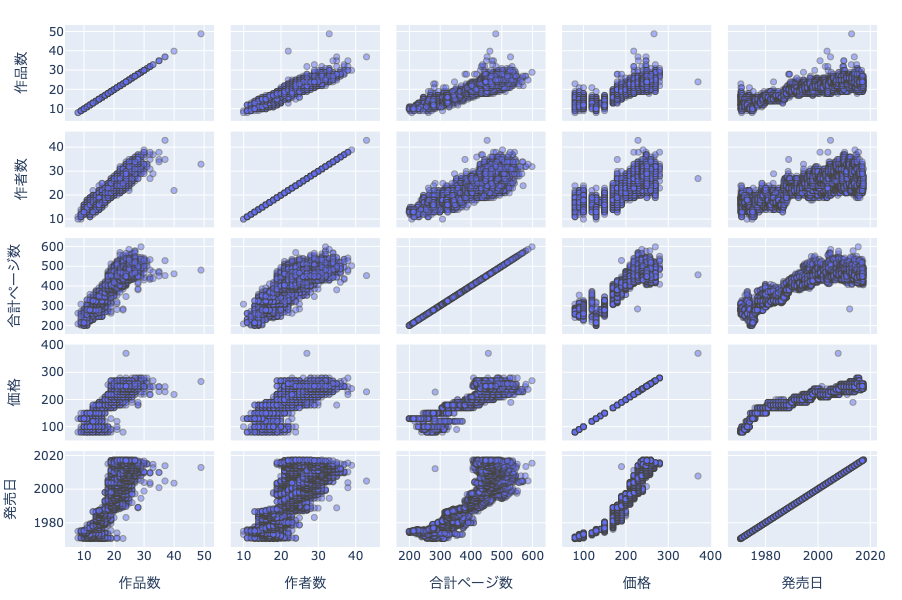

In [16]:
# 散布図行列のオブジェクトを作成
# 散布図行列では、'作品数'、'作者数'、'合計ページ数'、'価格'、'発売日'を描画
# 各データポイントにマウスをホバーすると、'雑誌巻号名'が表示されるよう設定
# 不透明度(opacity)を0.5に設定して、データポイントが重なった時に見やすくする
# グラフの高さを600ピクセルに設定
fig = px.scatter_matrix(
    df_cm,
    dimensions=["作品数", "作者数", "合計ページ数", "価格", "発売日"],
    hover_name="雑誌巻号名",
    opacity=0.5,
    height=600,
)

# マーカーのスタイルを設定
# line_width：線幅
fig.update_traces(
    marker={
        "line_width": 1,
    }
)

# 散布図行列を表示
show_fig(fig)

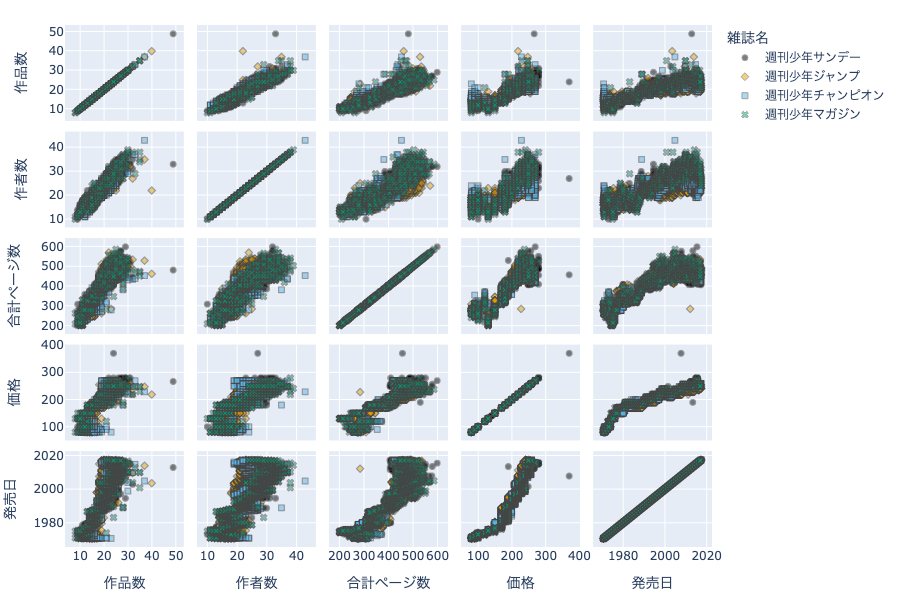

In [17]:
# 散布図行列のオブジェクトを作成
# '作品数'、'作者数'、'合計ページ数'、'価格'、'発売日'の各次元間での関係を描画
# '雑誌名'によって色分けし、さらに'雑誌名'によって異なるシンボル（マーカー形状）を使用
# OKABE_ITOカラーパレットを使用して、データポイントの色を指定
# 各データポイントにマウスをホバーすると、'雑誌巻号名'が表示されるよう設定
# 不透明度(opacity)を0.5に設定して、データポイントが重なった時に見やすくする
# グラフの高さを600ピクセルに設定
fig = px.scatter_matrix(
    df_cm,
    dimensions=["作品数", "作者数", "合計ページ数", "価格", "発売日"],
    color="雑誌名",
    symbol="雑誌名",
    color_discrete_sequence=OKABE_ITO,
    hover_name="雑誌巻号名",
    opacity=0.5,
    height=600,
)

# マーカーのスタイルを設定
# line_width：線幅
fig.update_traces(
    marker={
        "line_width": 1,
    }
)

# 散布図行列を表示
show_fig(fig)

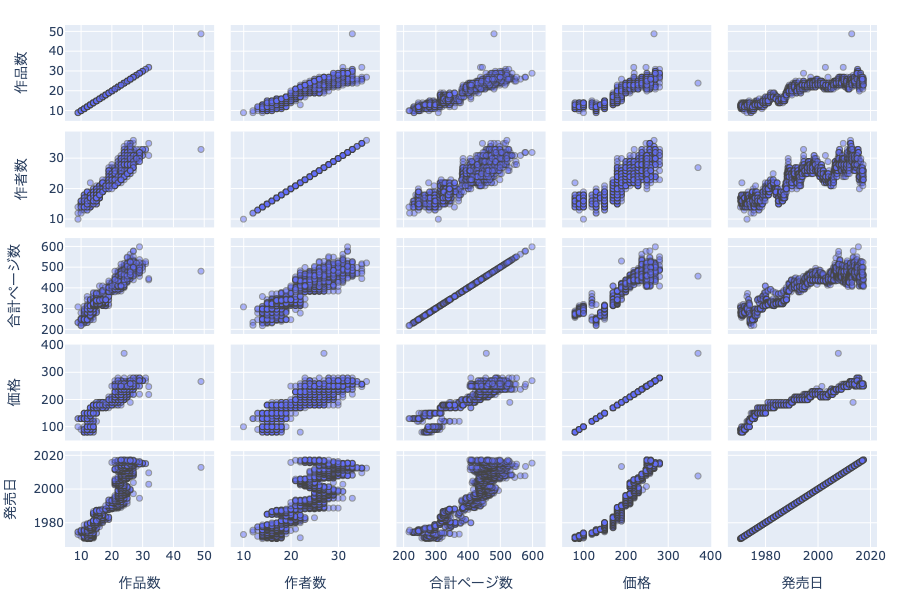

In [18]:
# 雑誌名が週刊少年サンデーと合致する行を抽出
df_cm_mc = df_cm[df_cm["雑誌名"] == "週刊少年サンデー"].reset_index(drop=True)

# 散布図行列のオブジェクトを作成
# '作品数'、'作者数'、'合計ページ数'、'価格'、'発売日'を各次元として使用
# 各データポイントにマウスをホバーすると、'雑誌巻号名'が表示される
# 不透明度を0.5に設定し、グラフの高さを600ピクセルに設定
# タイトルを現在のマンガ雑誌名('mcname')に設定
# 色はOKABE_ITOカラーパレットの現在のインデックスに対応する色を使用
fig = px.scatter_matrix(
    df_cm_mc,
    dimensions=["作品数", "作者数", "合計ページ数", "価格", "発売日"],
    hover_name="雑誌巻号名",
    opacity=0.5,
    height=600,
)

# マーカーのスタイルを設定
# line_width：線幅
fig.update_traces(
    marker={
        "line_width": 1,
    }
)

# 散布図行列を表示
show_fig(fig)

(matrix-an)=
### アニメデータ

In [19]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ae = pd.read_csv(DIR_AN / FN_AE)
df_ac_act = pd.read_csv(DIR_AN / FN_AC_ACT)

In [20]:
# アニメ作品ごとの統計情報を集計して可視化用のデータフレームを作成

# 'acid'（アニメ作品ID）と'acname'（アニメ作品名）を基準にグルーピング
# 各アニメ作品ごとに'aeid'（各話ID）のユニーク数（各話数）と'date'（放送日）のユニーク数（放送日数）を計算
df_an = df_ae.groupby(["acid", "acname"])[["aeid", "date"]].nunique().reset_index()

# アニメ作品ごとに声優のユニーク数（声優数）を集計
# 'acid'（アニメ作品ID）を基準にグルーピングし、'actid'（声優ID）のユニーク数を計算
# その結果を辞書として保存し、アニメ作品IDをキーとして声優数を格納
acid2n_act = df_ac_act.groupby("acid")["actid"].nunique().to_dict()
df_an["n_act"] = df_an["acid"].map(acid2n_act)

# アニメ作品ごとの最初の放送日を追加
# 'acid'（アニメ作品ID）を基準にグルーピングし、'first_date'（最初の放送日）の最小値を取得
# その結果を辞書として保存し、アニメ作品IDをキーとして声優数を格納
acid2fdate = df_ac_act.groupby("acid")["first_date"].min().to_dict()
df_an["first_date"] = pd.to_datetime(df_an["acid"].map(acid2fdate))

# アニメ作品のタイトルの文字数
df_an["l_acname"] = df_an["acname"].str.len()

In [21]:
# カラム名を変更して、結果をわかりやすくする
df_an = df_an.rename(
    columns={
        "acname": "アニメ作品名",
        "aeid": "各話数",
        "date": "放送日数",
        "n_act": "声優数",
        "l_acname": "作品名の文字数",
        "first_date": "初回放送日",
    }
)

In [22]:
# 可視化対象のDataFrameを確認
df_an.head()

,acid,アニメ作品名,各話数,放送日数,声優数,初回放送日,作品名の文字数
0,C10001,ギャラクシー エンジェル,24,23,9.0,2001-04-08,12
1,C10003,PROJECT ARMS,26,26,11.0,2001-04-08,12
2,C10005,探偵少年カゲマン,6,5,12.0,2001-11-28,8
3,C10006,Mr.Digital TOKORO the comical cartoon ［第1期］,120,120,NaN,NaT,43
4,C10008,GEAR戦士[ギアファイター] 電童,38,38,10.0,2000-10-04,19


In [23]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_an, DIR_OUT_AN, "an")

DataFrame is saved as '../../../data/an/output/vol2/04/matrix/an.csv'.


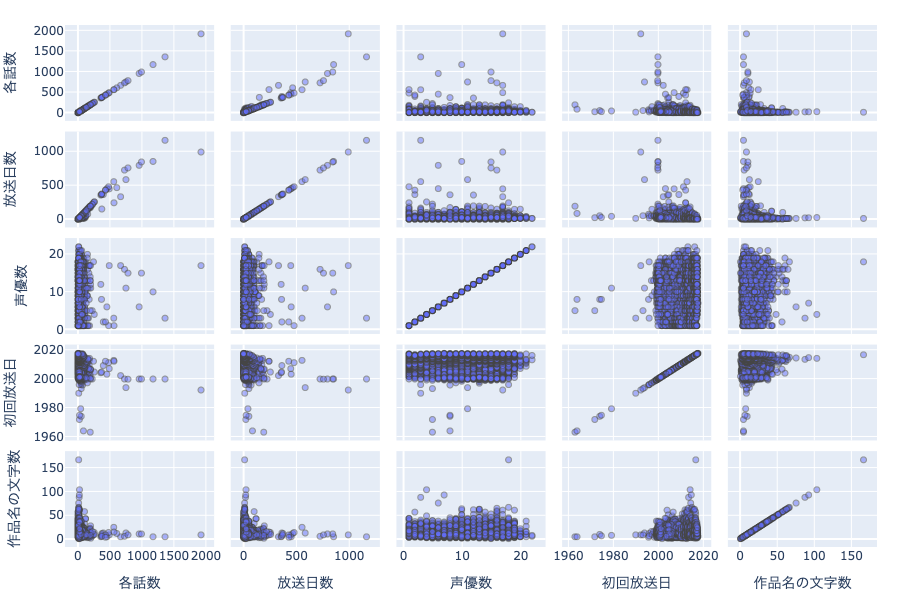

In [24]:
# 散布図行列のオブジェクトを作成
# 各データポイントにマウスをホバーすると、'アニメ作品名'が表示されるよう設定
# 不透明度(opacity)を0.5に設定して、データポイントが重なった時に見やすくする
# グラフの高さを600ピクセルに設定
fig = px.scatter_matrix(
    df_an,
    dimensions=["各話数", "放送日数", "声優数", "初回放送日", "作品名の文字数"],
    hover_name="アニメ作品名",
    opacity=0.5,
    height=600,
)

# マーカーのスタイルを設定
# line_width：線幅
fig.update_traces(
    marker={
        "line_width": 1,
    }
)

# 散布図行列を表示
show_fig(fig)

(matrix-gm)=
### ゲームデータ

In [25]:
# pandasのread_csv関数でCSVファイルの読み込み
df_pkg_pf = pd.read_csv(DIR_GM / FN_PKG_PF)

In [26]:
# dateをdatetime型に変換
df_pkg_pf["date"] = pd.to_datetime(df_pkg_pf["date"])

# 'pfname'（プラットフォーム名）ごとに各種数値を集計
# 'pkgid'はユニークな値の数（パッケージ数）、'publisher'はユニークな値の数（パブリッシャー数）、
# 'price'は平均価格、'date'は最小値（最初の発売日）
df_gm = (
    df_pkg_pf.groupby("pfname")[["pkgid", "publisher", "price", "date"]]
    .agg({"pkgid": "nunique", "publisher": "nunique", "price": "mean", "date": "min"})
    .reset_index()
)

# カラム名をわかりやすい名前に変更
df_gm = df_gm.rename(
    columns={
        "pfname": "プラットフォーム名",
        "pkgid": "パッケージ数",
        "publisher": "パブリッシャー数",
        "price": "平均価格",
        "date": "最初の発売日",
    }
)

In [27]:
# 可視化対象のDataFrameを確認
df_gm.head()

,プラットフォーム名,パッケージ数,パブリッシャー数,平均価格,最初の発売日
0,3DO,115,68,8261.913043,1994-03-20
1,64DD,2,1,NaN,2000-04-21
2,ClassicMacOS,13,3,615.384615,1997-09-21
3,MSX,1,1,5800.000000,1986-04-18
4,MSX2,4,4,8800.000000,1985-12-18


In [28]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_gm, DIR_OUT_GM, "gm")

DataFrame is saved as '../../../data/gm/output/vol2/04/matrix/gm.csv'.


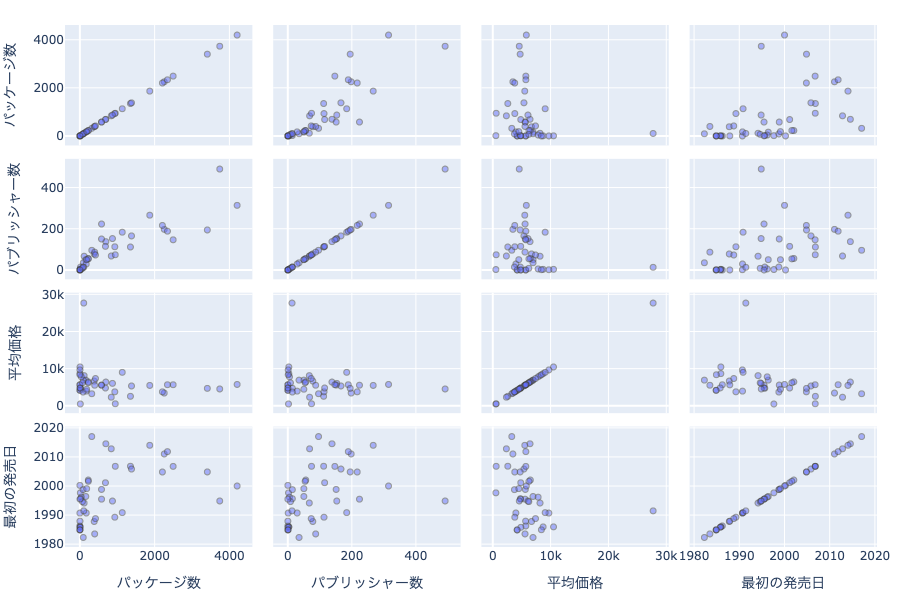

In [29]:
# 散布図行列のオブジェクトを作成
# 'パッケージ数'、'パブリッシャー数'、'平均価格'、'最初の発売日'を分析するための各次元として使用
# 各データポイントにマウスをホバーすると、'プラットフォーム名'が表示されるよう設定
# 不透明度(opacity)を0.5に設定して、データポイントが重なった時に見やすくする
# グラフの高さを600ピクセルに設定
fig = px.scatter_matrix(
    df_gm,
    dimensions=["パッケージ数", "パブリッシャー数", "平均価格", "最初の発売日"],
    hover_name="プラットフォーム名",
    opacity=0.5,
    height=600,
)

# マーカーのスタイルを設定
# 線幅を1に設定
fig.update_traces(
    marker={
        "line_width": 1,
    }
)

# 散布図行列を表示
show_fig(fig)